# Hurricane Dorian Sentinel-3

    Version: 1.0
    Date:    14/10/2019
    Author:  Ben Loveday (Plymouth Marine Laboratory ) and Hayley Evers-King (EUMETSAT)
    Credit:  This code was developed for EUMETSAT under contracts for the Copernicus 
             programme.
    License: This code is offered as open source and free-to-use in the public domain, 
             with no warranty.

**What is this notebook for?**

This notebook shows plots OLCI L1 RGB and L2 complex water TSM products for Typhoon Hagibis

**What specific tools does this notebook use?**

Beyond standard tools, the notebook imports for helping us to plot data (image_tools.py).

***

Lets begin....

Python is divided into a series of modules that each contain a series of methods for specific tasks. The box below imports all of the moduls we need to complete our plotting task

In [1]:
%matplotlib inline

import os
import sys
import numpy as np
import xarray as xr
import matplotlib
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib import gridspec
import matplotlib.patheffects as path_effects
import matplotlib.ticker as mticker
import glob
from skimage import exposure
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import warnings
warnings.filterwarnings('ignore')

# specific tools (which can be found here ../Hub_tools/)
sys.path.append(os.path.dirname(os.path.dirname(os.getcwd())) + '/Hub_Tools/')
import image_tools as img

All of our plotting is managed by a single function, that we call for each image. The function itself is in the box below.

In [2]:
def make_plot(swh_dir, nc_dir, label, fname, plot_extents=None, fsz=32,\
              SWH_min=None, SWH_max=None, SSHA_min=None, SSHA_max=None):

    # manage raster data
    if '_OL_2_' in nc_dir:
        nc_fid = xr.open_dataset(os.path.join(nc_dir,'geo_coordinates.nc'))
        raster_LON = nc_fid.get('longitude').data
        raster_LAT = nc_fid.get('latitude').data
        nc_fid.close()
        
        nc_fid = xr.open_dataset(os.path.join(nc_dir,'chl_nn.nc'))
        raster_VAR = nc_fid.get('CHL_NN').data
        nc_fid.close()
        
    elif '_OL_1_' in nc_dir:
        nc_fid = xr.open_dataset(os.path.join(nc_dir,'geo_coordinates.nc'))
        raster_LON = nc_fid.get('longitude').data
        raster_LAT = nc_fid.get('latitude').data
        nc_fid.close()
        
        radiometry_type = 'Oa%s_radiance'
        num_channels = 11
        for rad_channel_number in range(1, num_channels+1):
            rad_channel = radiometry_type % (str(rad_channel_number).zfill(2))
            rad_file = os.path.join(nc_dir, rad_channel + '.nc') 
            rad_fid = xr.open_dataset(rad_file)
            exec("globals()['Ch%s'] = rad_fid.%s.data" % (str(rad_channel_number).zfill(2),rad_channel))
            rad_fid.close()

        # make channels according to OLCI L1 tristimulus
        red = np.log10(1.0 + 0.01 * Ch01 + 0.09 * Ch02 + 0.35 * Ch03 + 0.04 \
                       * Ch04 + 0.01 * Ch05 + 0.59 * Ch06 + 0.85 * Ch07 + 0.12 \
                       * Ch08 + 0.07 * Ch09 + 0.04 * Ch10)
        
        green = np.log10(1.0 + 0.26 * Ch03 + 0.21 * Ch04 + 0.50 * Ch05 + Ch06 \
                         + 0.38 * Ch07 + 0.04 * Ch08 + 0.03 * Ch09 + 0.02 * Ch10)
        
        blue = np.log10(1.0 + 0.07 * Ch01 + 0.28 * Ch02 + 1.77 * Ch03 \
                        + 0.47 * Ch04 + 0.16 * Ch05)
        
        # --------------------------- image manipulation -------------------------------

        # truncate image
        red = img.truncate_image(red) ; green = img.truncate_image(green) ; blue = img.truncate_image(blue)
    
        # build RGB array
        height = np.shape(red)[0] ; width = np.shape(red)[1] 
        image_array = np.zeros((height, width, 3), dtype=np.float32)
        image_array[..., 0] = red ; image_array[..., 1] = green ; image_array[..., 2] = blue

        # normalise array
        image_array = img.norm_image(image_array, contrast=[1, 1, 1], unhitch=True)
        
        # histogram channels
        image_array = exposure.equalize_adapthist(image_array, nbins=512)
        
        # --------------------------- image manipulation done ---------------------------
  
        # build color palette
        mesh_rgb = image_array[:, :-1, :]
        colorTuple = mesh_rgb.reshape((mesh_rgb.shape[0] * mesh_rgb.shape[1]), 3)
        colorTuple = np.insert(colorTuple, 3, 1.0, axis=1)
    else:
        nc_fid =  xr.open_dataset(os.path.join(nc_dir,'geodetic_in.nc'))
        raster_LON = nc_fid.get('longitude_in').data[:,100:-100]
        raster_LAT = nc_fid.get('latitude_in').data[:,100:-100]
        nc_fid.close()

        nc_fid = xr.open_dataset(os.path.join(nc_dir,'S7_BT_in.nc'))
        raster_VAR = nc_fid.get('S7_BT_in').data[:,100:-100]
        nc_fid.close()
        raster_VAR = img.gap_fill(raster_VAR)

    # manage altimetry data
    nc_fid = xr.open_dataset(os.path.join(swh_dir,'standard_measurement.nc'))
    LON = nc_fid.get('lon_01').data
    LAT = nc_fid.get('lat_01').data
    SWH = nc_fid.get('swh_ocean_01_ku').data
    SSHA = nc_fid.get('ssha_01_ku').data
    FLAGS = nc_fid.get('swh_ocean_qual_01_ku').data
    RMS = nc_fid.get('swh_ocean_rms_01_ku').data
    RAIN = nc_fid.get('rain_flag_01_ku').data
    SURF_TYPE = nc_fid.get('surf_type_01').data
    nc_fid.close()

    LON[LON>180] = LON[LON>180]-360

    # subset
    ii = np.where((LON>plot_extents[0]) & (LON<plot_extents[1]) & (LAT>plot_extents[2]) & (LAT<plot_extents[3]))
    LON = LON[ii] ; LAT = LAT[ii] ; SWH = SWH[ii] ; SSHA = SSHA[ii]
    FLAGS = FLAGS[ii] ; RMS = RMS[ii] ; RAIN = RAIN[ii] ; SURF_TYPE = SURF_TYPE[ii]

    # flag
    ii = np.where((RAIN != 0) | (SURF_TYPE != 0) | (FLAGS != 0))
    SWH[ii] = np.nan ; SSHA[ii] = np.nan

    # normalise
    if SSHA_min==None or SSHA_max==None:
        SSHA_min = np.nanmin(SSHA) ; SSHA_max = np.nanmax(SSHA)    
    SSHA = (SSHA - SSHA_min)/(SSHA_max - SSHA_min)

    if SWH_min==None or SWH_max==None:
        SWH_min = np.nanmin(SWH) ; SWH_max = np.nanmax(SWH)
    SWH = (SWH - SWH_min)/(SWH_max - SWH_min)
    
    # init land polygons
    land_resolution = '10m'
    land_poly = cfeature.NaturalEarthFeature('physical', 'land', land_resolution,
                                        edgecolor='k',
                                        facecolor=cfeature.COLORS['land'])
    # init plot
    fig1 = plt.figure(figsize=(21, 20), dpi=300)
    plt.rc('font', size=fsz)
    matplotlib.rcParams['contour.negative_linestyle'] = 'solid'
    gs = gridspec.GridSpec(2, 1, height_ratios=[200,5])
    m = plt.subplot(gs[0,0], projection=ccrs.PlateCarree())

    # make raster plots
    if '_OL_2_' in nc_dir:
        plot1 = m.pcolormesh(raster_LON, raster_LAT, raster_VAR, zorder=0,vmin=-2,vmax=2)
    elif '_SL_1_' in nc_dir:
        plot1 = m.pcolormesh(raster_LON, raster_LAT, raster_VAR, zorder=0,cmap=plt.cm.bone_r)
    else:
        plot1 = m.pcolormesh(raster_LON, raster_LAT, red * np.nan, color=colorTuple,\
                             clip_on = True, edgecolors=None, zorder=0, linewidth=0.6,\
                             transform=ccrs.PlateCarree())

    # calculate point gradients: HAVE TO TAKE CARE WITH SCALING HERE.....FIXME!
    GRAD_LINES=False
    if GRAD_LINES:
        GRADX = np.zeros(len(LON))
        GRADY = np.zeros(len(LON))

        for ii in np.arange(len(LON)):
            if ii == 0 or ii == len(LON) -1:
                continue
            else:
                GRADX[ii] = (LON[ii+1] - LON[ii-1])
                GRADY[ii] = (LAT[ii+1] - LAT[ii-1])

        plt.quiver(LON, LAT, -1*GRADY, GRADX,\
               color=plt.cm.YlOrRd(SSHA/np.nanmax(abs(SSHA))),angles='xy',scale_units='xy', scale=1,\
               width=np.nanmean(GRADY)*0.025,headaxislength=0,headlength=0)
        plt.quiver(LON, LAT, GRADY, -1*GRADX,\
               color=plt.cm.YlOrRd(SSHA/np.nanmax(abs(SSHA))),angles='xy',scale_units='xy', scale=1,\
               width=np.nanmean(GRADY)*0.025,headaxislength=0,headlength=0)
        m.plot(LON, LAT, 'k', zorder=10, alpha=0.25)
    else:
        # make scatter plots
        lin = 8000 ; nlin = 3 # set linear and non-linear scalings for point sizes
        m.scatter(LON, LAT, s=SWH**nlin*lin, c=SSHA, zorder=10, cmap=plt.cm.YlOrRd, vmin=0, vmax=1, alpha=0.25)

    # make scatter key
    nsum = 0 ; noff = -0.1 ; nstart = 22.5 ; ninc = 0.8 ; nitems = 5.0 ; re_scale = SWH_max/7.5
    for ii in np.arange(nitems):
        niter = (nitems-ii)/(nitems)
        m.scatter(-71.6, nstart+nsum, s=(niter/re_scale)**nlin*lin,\
                  c='0.5', zorder=2, edgecolor='k')
        txt = plt.annotate("{0:.2f}".format(niter*SWH_max/re_scale)+' m', xy=(-71.0, nstart+nsum+noff), \
                   xycoords='data', size=fsz/1.5, color='r', zorder=100, annotation_clip=False)
        nsum = nsum + niter
        
    # make scale labels
    txt = plt.annotate('SSHA [m]', xy=(-71.6, 30.5), \
                   xycoords='data', size=fsz/1.5,\
                   color='#FFB90F', zorder=100, annotation_clip=False)
    txt.set_path_effects([path_effects.Stroke(linewidth=5, foreground='black'), path_effects.Normal()])

    txt = plt.annotate('SWH [m]', xy=(-71.6, 25.7), \
                   xycoords='data', size=fsz/1.5,\
                   color='#FFB90F', zorder=100, annotation_clip=False)
    txt.set_path_effects([path_effects.Stroke(linewidth=5, foreground='black'), path_effects.Normal()])

    # embellish map
    m.coastlines(resolution=land_resolution, color='k', linewidth=0.5, zorder=6)
    m.add_feature(land_poly, color='0.5', zorder=5)

    m.set_extent(plot_extents, crs=ccrs.PlateCarree())
    g1 = m.gridlines(draw_labels = True, zorder=20, color='0.5', linestyle='--',linewidth=0.5)

    g1.xlocator = mticker.FixedLocator([-86,-82,-78,-74,-70])
    g1.ylocator = mticker.FixedLocator([18,22,26,30,34])

    g1.xlabels_top = False
    g1.ylabels_right = False
    g1.xlabel_style = {'size': fsz, 'color': 'black'}
    g1.ylabel_style = {'size': fsz, 'color': 'black'}

    # label plot
    txt = plt.annotate(label, xy=(0.005, 0.005), xycoords='axes fraction', size=fsz/1.5,
                   color='#FFB90F', zorder=100, annotation_clip=False)
    txt.set_path_effects([path_effects.Stroke(linewidth=5, foreground='black'), path_effects.Normal()])

    # ------------------------------ make inset colorbar -------------------------------------------
    ax = plt.gca()
    cbaxes = inset_axes(ax, width="100%", height="100%", loc='upper left',
                   bbox_to_anchor=(0.615,1-0.35,.5,.3), bbox_transform=ax.transAxes)
    cbaxes.yaxis.tick_right()
    cbaxes.tick_params(axis='y', colors='r')

    x = np.asarray([np.linspace(SSHA_min,SSHA_max,100),np.linspace(SSHA_min,SSHA_max,100)\
                   ,np.linspace(SSHA_min,SSHA_max,100),np.linspace(SSHA_min,SSHA_max,100)]).astype(float).T
  
    color_map = cbaxes.imshow(x)
    color_map.set_cmap(plt.cm.YlOrRd)

    color_map.axes.get_xaxis().set_ticks([])
    color_map.axes.get_xaxis().set_ticklabels([])

    # need to map 0 to 100 to SSHA_min to SSHA_max
    ticks = []
    tick_labels = []

    for ii in [-0.1,0,0.1,0.2,0.3,0.4,0.5]:
        ticks.append((ii - SSHA_min)/(SSHA_max - SSHA_min)*100)

    for item in ([cbaxes.title, cbaxes.xaxis.label, cbaxes.yaxis.label] +
             cbaxes.get_xticklabels() + cbaxes.get_yticklabels()):
        item.set_fontsize(fsz/1.5)

    color_map.axes.set_yticks(ticks)
    color_map.axes.set_yticklabels([-0.1,0,0.1,0.2,0.3,0.4,0.5])
    # ------------------------------ make inset colorbar done ---------------------------------------

    # save figure
    plt.savefig(fname, bbox_inches='tight')
    
    # save figure colourbar if OLCI L2
    if '_OL_2_' in nc_dir:
        plt.gca().set_visible(False)
        ax = plt.subplot(gs[1,0])
        cbar = plt.colorbar(plot1, cax=ax, orientation='horizontal')
        cbar.set_label('Chlorophyll [mg.m$^{-3}$]', fontsize=fsz)
        ticks = [-2,-1,0,1,2]
        labels=[10**-2,10**-1,10**0,10**1,10**2]
        cbar.set_ticks(ticks)
        cbar.ax.set_xticklabels(labels)
        plt.savefig(fname+'_colbar', bbox_inches='tight')

Here we run the main part of our script, which calls our plotting function for each of the scenes it finds

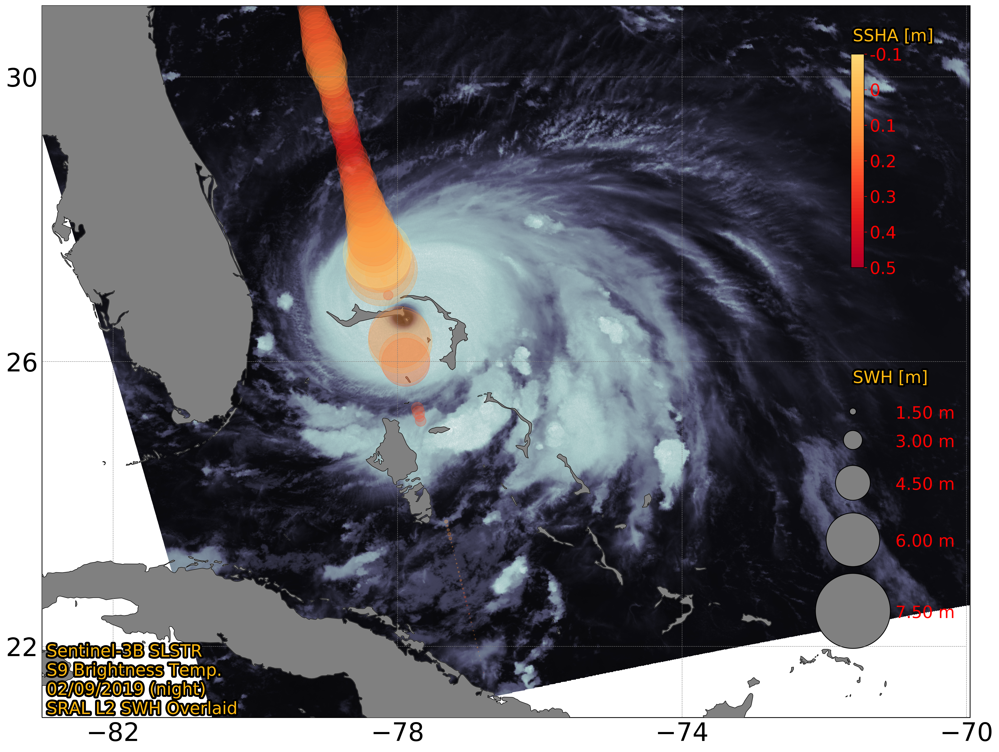

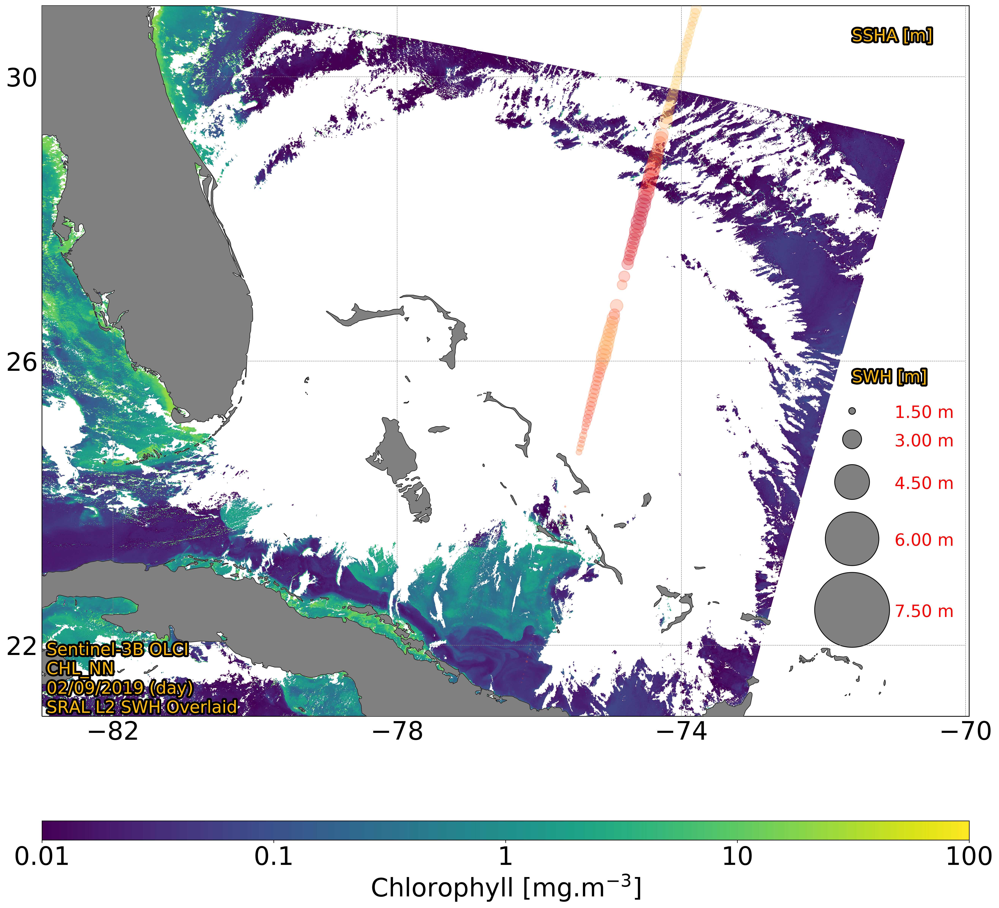

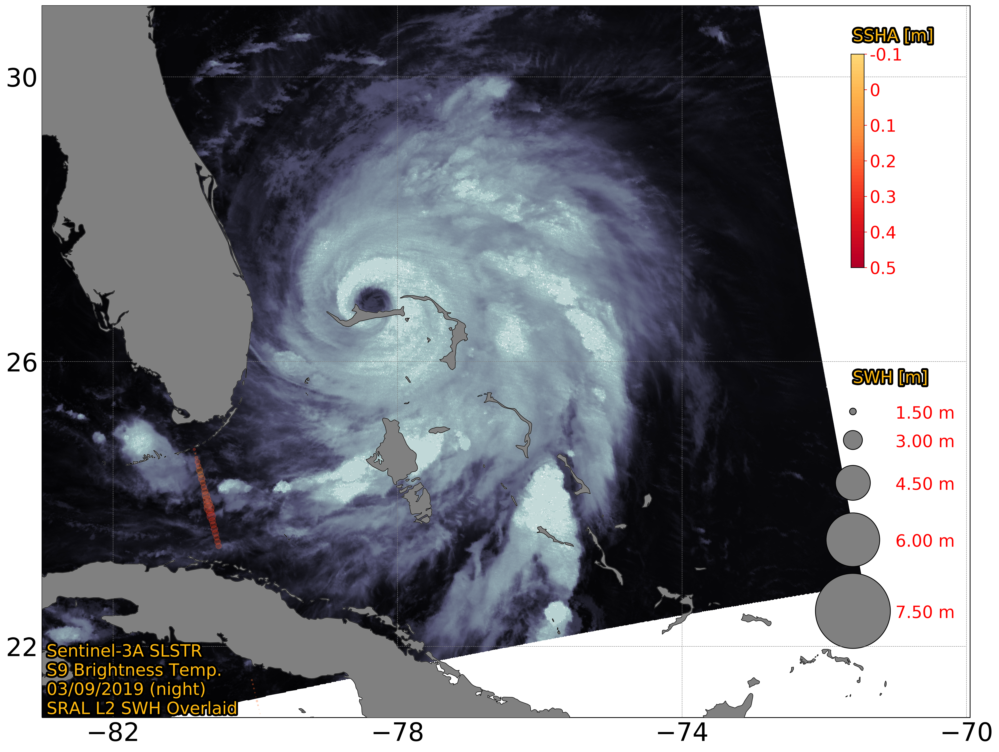

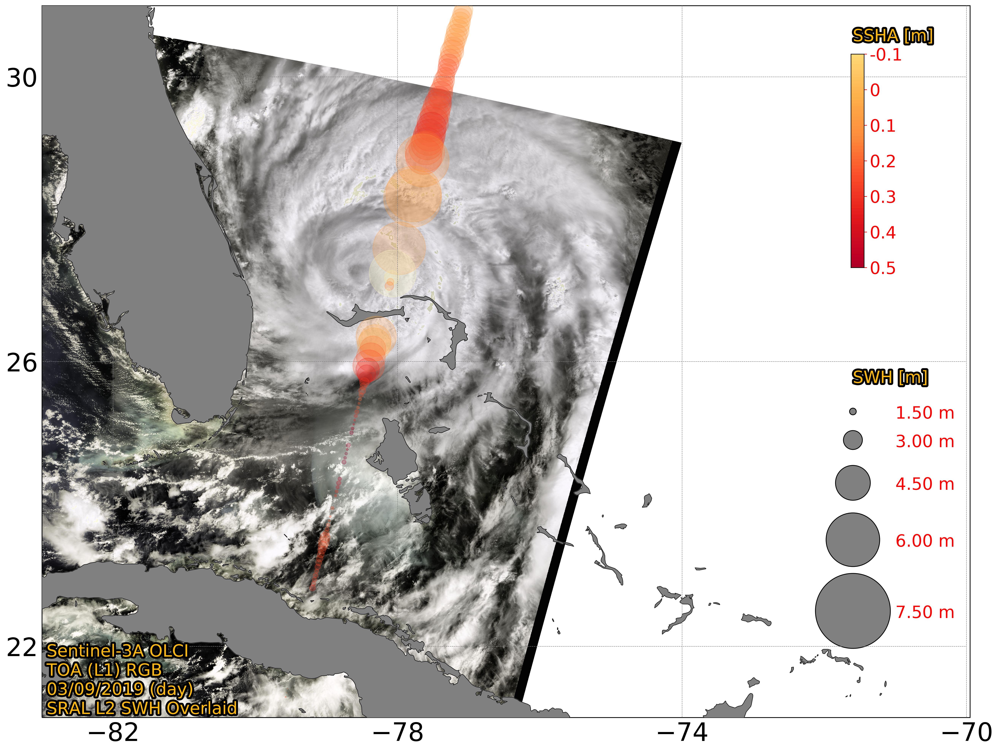

In [3]:
if __name__ == '__main__':

    data_directory = '/home/jovyan/work/products/Dorian/'
    plot_extents = [-83.00, -69.95, 21.00, 31.00]

    SWH_dirs = ['S3B_SR_2_WAT____20190902T022457_20190902T031225_20190927T175645_2848_029_231______MAR_O_NT_003.SEN3',\
                'S3B_SR_2_WAT____20190902T145920_20190902T154559_20190928T070007_2799_029_239______MAR_O_NT_003.SEN3',\
                'S3A_SR_2_WAT____20190903T023809_20190903T032545_20190928T190107_2856_049_003______MAR_O_NT_003.SEN3',\
                'S3A_SR_2_WAT____20190903T151240_20190903T155915_20190929T072834_2795_049_011______MAR_O_NT_003.SEN3']
    RASTER_dirs = ['S3B_SL_1_RBT____20190902T025313_20190902T025613_20190903T160218_0179_029_232_0360_MAR_O_NT_003.SEN3',\
                   'S3B_OL_2_WFR____20190902T151607_20190902T151907_20190904T003825_0179_029_239_2520_MAR_O_NT_002.SEN3',\
                   'S3A_SL_1_RBT____20190903T030633_20190903T030933_20190904T112842_0180_049_004_0360_MAR_O_NT_003.SEN3',\
                   'S3A_OL_1_EFR____20190903T152927_20190903T153227_20190904T214648_0180_049_011_2520_MAR_O_NT_002.SEN3'] 
    labels = ['Sentinel-3B SLSTR\nS9 Brightness Temp.\n02/09/2019 (night)\nSRAL L2 SWH Overlaid',\
              'Sentinel-3B OLCI\nCHL_NN\n02/09/2019 (day)\nSRAL L2 SWH Overlaid',\
              'Sentinel-3A SLSTR\nS9 Brightness Temp.\n03/09/2019 (night)\nSRAL L2 SWH Overlaid',\
              'Sentinel-3A OLCI\nTOA (L1) RGB\n03/09/2019 (day)\nSRAL L2 SWH Overlaid']
    
    fouts = ['Panel1','Panel2','Panel3','Panel4']
    
    for SWH_dir, RASTER_dir, label, fout in zip(SWH_dirs, RASTER_dirs, labels, fouts):
        make_plot(os.path.join(data_directory,SWH_dir),\
                  os.path.join(data_directory,RASTER_dir),\
                  label, fout, plot_extents, SSHA_min=-0.325, SSHA_max=0.595, SWH_min=0.0, SWH_max=7.225)